# Import libraries and Set basic parameters

In [ ]:
%matplotlib inline

In [ ]:
import random
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
import torch
import torch.nn as nn
from torch.utils.data import DataLoader
from torch.optim import Adam
from torchvision.datasets import ImageFolder
from torchvision import transforms
from torchvision.utils import make_grid

In [ ]:
seed = 42

random.seed(42)
torch.manual_seed(42)
torch.use_deterministic_algorithms(True)

image_size = 64
latent_size = 100
G_feature_maps = 64

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

# Load Dataset

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [ ]:
!unzip '/content/gdrive/My Drive/Colab Notebooks/Deep Learning/img_align_celeba.zip' -d './celeba'

In [ ]:
dataset = ImageFolder(root='./celeba',
                      transform=transforms.Compose([
                          transforms.Resize(image_size),
                          transforms.CenterCrop(image_size), # ensures image size of 64x64
                          transforms.ToTensor(),
                          transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                      ]))

In [ ]:
dataloader = DataLoader(dataset, batch_size=128, shuffle=True, num_workers=2)

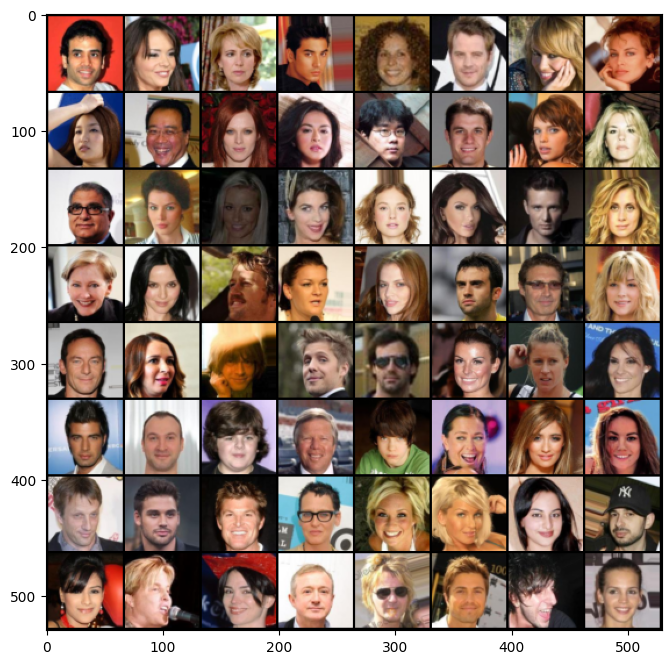

In [ ]:
image_batch = next(iter(dataloader))
image_batch = image_batch[0][:64] # Take only 64 images
plt.figure(figsize=(8,8))
plt.imshow(make_grid(image_batch, normalize=True).permute(1,2,0))

# Generator Class

In [ ]:
class Generator(nn.Module):
  def __init__(self):
    super(Generator, self).__init__()
    self.layers = nn.Sequential(
        # Size of the latent vector using which we generate images = 100, so in_channels = 100
        # Number of features maps = 64, so out_channels = 64 * 8
        nn.ConvTranspose2d(latent_size, out_channels=64 * 8, kernel_size=4, stride=1, padding=0, bias=False),
        nn.BatchNorm2d(64 * 8),
        nn.ReLU(inplace=True),

        nn.ConvTranspose2d(in_channels=64 * 8, out_channels=64 * 4, kernel_size=4, stride=2, padding=1, bias=False),
        nn.BatchNorm2d(64 * 4),
        nn.ReLU(inplace=True),

        nn.ConvTranspose2d(in_channels=64 * 4, out_channels=64 * 2, kernel_size=4, stride=2, padding=1, bias=False),
        nn.BatchNorm2d(64 * 2),
        nn.ReLU(inplace=True),

        nn.ConvTranspose2d(in_channels=64 * 2, out_channels=64, kernel_size=4, stride=2, padding=1, bias=False),
        nn.BatchNorm2d(64),
        nn.ReLU(inplace=True),

        # out_channels = 3 for RGB
        nn.ConvTranspose2d(in_channels=64, out_channels=3, kernel_size=4, stride=2, padding=1, bias=False),
        nn.Tanh()
    )

  def forward(self, input):
    return self.layers(input)

In [ ]:
def weights_init(layer):
    classname = layer.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(layer.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(layer.weight.data, 1.0, 0.02)
        nn.init.constant_(layer.bias.data, 0)

# Discriminator Class

In [ ]:
class Discriminator(nn.Module):
  def __init__(self):
    super(Discriminator, self).__init__()
    self.layers = nn.Sequential(
        # Feature maps: 64
        nn.Conv2d(3, 64, 4, 2, 1, bias=False),
        nn.LeakyReLU(0.2, inplace=True),

        nn.Conv2d(64, 64 * 2, 4, 2, 1, bias=False),
        nn.BatchNorm2d(64 * 2),
        nn.LeakyReLU(0.2, inplace=True),

        nn.Conv2d(64 * 2, 64 * 4, 4, 2, 1, bias=False),
        nn.BatchNorm2d(64 * 4),
        nn.LeakyReLU(0.2, inplace=True),

        nn.Conv2d(64 * 4, 64 * 8, 4, 2, 1, bias=False),
        nn.BatchNorm2d(64 * 8),
        nn.LeakyReLU(0.2, inplace=True),

        nn.Conv2d(64 * 8, 1, 4, 1, 0, bias=False),
        nn.Sigmoid()
    )

  def forward(self, input):
    return self.layers(input)

# Loss Functions and Optimizers

In [ ]:
G = Generator().to(device)
G.apply(weights_init);

In [ ]:
D = Discriminator().to(device)
D.apply(weights_init);

In [ ]:
criterion = nn.BCELoss()

G_optimizer = Adam(G.parameters(), lr=0.002, betas=(0.5, 0.999))
D_optimizer = Adam(D.parameters(), lr=0.002, betas=(0.5, 0.999))

# Training

In [ ]:
num_epochs = 50

real_label = 1.0
fake_label = 0.0

In [ ]:
img_list = []
G_losses = []
D_losses = []
iters = 0

for epoch in range(num_epochs):
  for i, data in enumerate(dataloader, 0):
    # First train D with real images
    D.zero_grad()
    real_images = data[0].to(device)
    batch_size = real_images.size(0)
    label = torch.ones((batch_size,), dtype=torch.float, device=device) # label are all 1 for every image in batch
    output = D(real_images)
    output = output.view(-1) # To compare with label in next line
    D_loss_real = criterion(output, label) # Calculates log(D(x)), because in BCELoss only real samples are given
    D_loss_real.backward()
    D_avg_real_output = output.mean().item()


    # Generate fake images from G
    noise = torch.randn(batch_size, 100, 1, 1, device=device) # Latent vector of size 100
    fake_images = G(noise)
    label.fill_(fake_label)

    # Train D with generated images
    output = D(fake_images.detach())
    output = output.view(-1)
    D_loss_fake = criterion(output, label) # Calculates log(1-D(G(x))), because in BCELoss only real samples are given
    D_loss_fake.backward()
    D_avg_fake_output = output.mean().item()

    D_loss = D_loss_real + D_loss_fake
    D_optimizer.step()

    # Train G
    G.zero_grad()
    label.fill_(real_label)
    output = D(fake_images)
    output = output.view(-1)
    # We use the label 1 for fake images instead of 0, using this we can optimize log(D(G(x))) instead of log(1-D(G(x))). This just gives better gradients.
    G_loss = criterion(output, label)
    G_loss.backward()
    D_avg_fake_next_output = output.mean().item()
    G_optimizer.step()

    # Output training stats
    if i % 50 == 0:
      print(f'[Epoch: {epoch+1}/{num_epochs}]\tImage: [{i+1}/{len(dataloader)}]\nLoss_D: {D_loss_real.item():.3f}\nAverage D(x) for real images: {D_avg_real_output:.3f}')
      print(f'Average D(x) for fake images: {D_avg_fake_output:.3f}')

    # Save Losses for plotting later
    G_losses.append(G_loss.item())
    D_losses.append(D_loss.item())

    # Check how the generator is doing by saving G's output on fixed_noise
    if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
      with torch.no_grad():
        fixed_noise = torch.randn(64, 100, 1, 1, device=device)
        fake = G(fixed_noise).detach().cpu()
      img_list.append(make_grid(fake, padding=2, normalize=True))
    iters += 1

[Epoch: 1/50]	Image: [1/1583]
Loss_D: 0.842
Average D(x) for real images: 0.503
Average D(x) for fake images: 0.355
[Epoch: 1/50]	Image: [51/1583]
Loss_D: 2.641
Average D(x) for real images: 0.400
Average D(x) for fake images: 0.000
[Epoch: 1/50]	Image: [101/1583]
Loss_D: 1.232
Average D(x) for real images: 0.572
Average D(x) for fake images: 0.148
[Epoch: 1/50]	Image: [151/1583]
Loss_D: 5.434
Average D(x) for real images: 0.032
Average D(x) for fake images: 0.013
[Epoch: 1/50]	Image: [201/1583]
Loss_D: 1.392
Average D(x) for real images: 0.512
Average D(x) for fake images: 0.432


# Results

In [ ]:
img_list = img_list[5:len(img_list)]

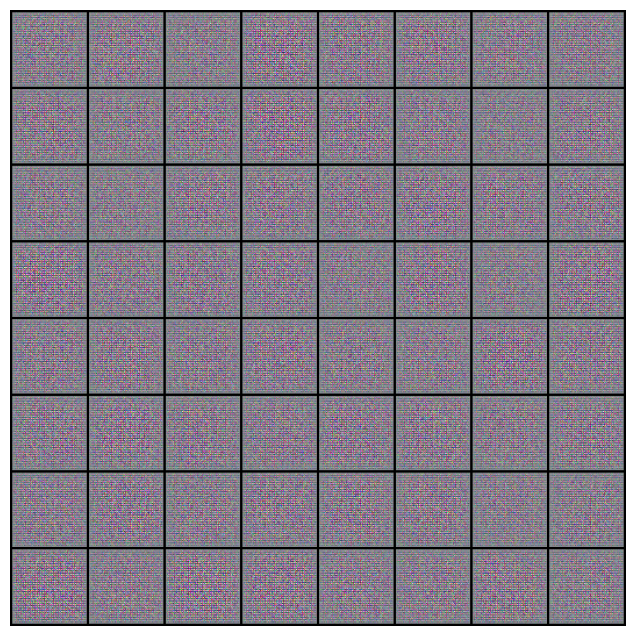

In [ ]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())